### Project | Module 3

## Project Goal
In this project, we will work on unsupervised machine learning. 
Imagine you are Uber and you want to give recommendations on where drivers should be to maximize their chances of finding a ride.
We will use Machine Learning to create this recommendation algorithm.

1. Try to see the number of optimal clusters
2. Find these clusters on a map
3. Now separate these clusters according to the time of day
4. Look at the difference between KMeans and DBSCAN

## Expectations

- Clean, well-commented code
- Clean data with EDA
- Clear board in Trello with logged time for each task
- Clear descriprion of each model
- At least 3 different models including Kmeans and DBSCAN
- Use Elbow method
- Use folium library to create the map
- Models implementation and comparison
- Vizualisation of the main results


## Deliverables

- '1. Uber.csv with clean and encoded data
- '2. Uber.ipynb' with all code concerning data cleaning and modelling
- '3. Slides/dashboard/notebook with your results (for each model and final table with models comparison).
- '4. Please state the conclusion about usability of each model.
- '5. Trello board.


Upon completion, add your deliverables to git. Then commit git and push your branch to the remote.

In [9]:
#Import your libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from datetime import datetime

from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import folium
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from sklearn.metrics import v_measure_score
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# I. Clean data

In [8]:
uber= pd.read_csv(r'C:/Users/olivi/Documents/Ironhack/IRONLABS_OM/Projet Uber/uber-raw-data-jul14.csv')

In [11]:
uber.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 796121 entries, 0 to 796120
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   Date/Time  796121 non-null  object 
 1   Lat        796121 non-null  float64
 2   Lon        796121 non-null  float64
 3   Base       796121 non-null  object 
dtypes: float64(2), object(2)
memory usage: 24.3+ MB


In [12]:
uber.head()

,Date/Time,Lat,Lon,Base
0,7/1/2014 0:03:00,40.7586,-73.9706,B02512
1,7/1/2014 0:05:00,40.7605,-73.9994,B02512
2,7/1/2014 0:06:00,40.7320,-73.9999,B02512
3,7/1/2014 0:09:00,40.7635,-73.9793,B02512
4,7/1/2014 0:20:00,40.7204,-74.0047,B02512


In [13]:
uber.describe()

,Lat,Lon
count,796121.000000,796121.000000
mean,40.739141,-73.972353
std,0.040551,0.058660
min,39.721400,-74.826000
25%,40.720900,-73.996100
50%,40.742500,-73.983200
75%,40.760800,-73.965100
max,41.341300,-72.309700


<AxesSubplot:>

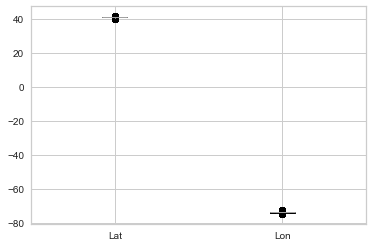

In [14]:
uber.boxplot()

In [15]:
uber['Date/Time']=pd.to_datetime(uber['Date/Time'], format='%m/%d/%Y %H:%M:%S')


In [16]:
uber.Base.value_counts()

B02617    310160
B02598    245597
B02682    196754
B02512     35021
B02764      8589
Name: Base, dtype: int64

In [17]:
uber.head()

,Date/Time,Lat,Lon,Base
0,2014-07-01 00:03:00,40.7586,-73.9706,B02512
1,2014-07-01 00:05:00,40.7605,-73.9994,B02512
2,2014-07-01 00:06:00,40.7320,-73.9999,B02512
3,2014-07-01 00:09:00,40.7635,-73.9793,B02512
4,2014-07-01 00:20:00,40.7204,-74.0047,B02512


In [18]:
uber['Date']=uber['Date/Time'].dt.day_name()
uber.head()

,Date/Time,Lat,Lon,Base,Date
0,2014-07-01 00:03:00,40.7586,-73.9706,B02512,Tuesday
1,2014-07-01 00:05:00,40.7605,-73.9994,B02512,Tuesday
2,2014-07-01 00:06:00,40.7320,-73.9999,B02512,Tuesday
3,2014-07-01 00:09:00,40.7635,-73.9793,B02512,Tuesday
4,2014-07-01 00:20:00,40.7204,-74.0047,B02512,Tuesday


In [19]:
uber_coord=uber.drop(columns=['Date/Time', 'Base', 'Date'])
uber_coord.head()

,Lat,Lon
0,40.7586,-73.9706
1,40.7605,-73.9994
2,40.7320,-73.9999
3,40.7635,-73.9793
4,40.7204,-74.0047


In [20]:
data_sample=uber_coord.sample(int(uber_coord.shape[0]*0.01))
data_sample.shape

(7961, 2)

In [21]:
data_sample.isna().sum()

Lat    0
Lon    0
dtype: int64

In [22]:
from pathlib import Path  
filepath = Path('C:/Users/olivi/Documents/Ironhack/IRONLABS_OM/Projet Uber/uber_clean.csv')  
filepath.parent.mkdir(parents=True, exist_ok=True)  
uber.to_csv(filepath) 

# II. Kmeans

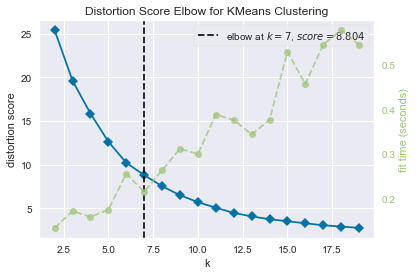

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [46]:
x = data_sample[['Lat', 'Lon']]
model = KMeans()
visualizer = KElbowVisualizer(estimator = model, k = (2,20))
visualizer.fit(x)
visualizer.poof()

In [89]:
model = KMeans(n_clusters=7)
y_kmeans=model.fit_predict(x)

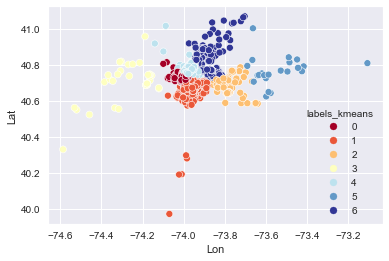

In [90]:
data_sample['labels_kmeans'] = model.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=data_sample, x='Lon', y='Lat', hue='labels_kmeans', palette='RdYlBu')
plt.show()

In [50]:
data_map_list_cluster1 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==0].values.tolist()
data_map_list_cluster2 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==1].values.tolist()
data_map_list_cluster3 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==2].values.tolist()
data_map_list_cluster4 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==3].values.tolist()
data_map_list_cluster5 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==4].values.tolist()
data_map_list_cluster6 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==5].values.tolist()
data_map_list_cluster7 = data_sample[['Lat','Lon']][data_sample['labels_kmeans']==6].values.tolist()
size_map_list_1 = len(data_map_list_cluster1)
size_map_list_2 = len(data_map_list_cluster2)
size_map_list_3 = len(data_map_list_cluster3)
size_map_list_4 = len(data_map_list_cluster4)
size_map_list_5 = len(data_map_list_cluster5)
size_map_list_6 = len(data_map_list_cluster6)
size_map_list_7 = len(data_map_list_cluster7)

In [51]:
m_p= folium.Map(location=[40.7128, -74.0060], zoom_start=10,tiles = "openstreetmap")

for point in range(0,size_map_list_1):
    folium.CircleMarker(data_map_list_cluster1[point], radius=2,color='blue',fill_color='lightblue',).add_to(m_p)
for point in range(0,size_map_list_2):
    folium.CircleMarker(data_map_list_cluster2[point], radius=2,color='green',fill_color='lightgreen',).add_to(m_p)
for point in range(0,size_map_list_3):
    folium.CircleMarker(data_map_list_cluster3[point], radius=2,color='purple',fill_color='purple',).add_to(m_p)
for point in range(0,size_map_list_4):
    folium.CircleMarker(data_map_list_cluster4[point], radius=2,color='orange',fill_color='orange',).add_to(m_p)
for point in range(0,size_map_list_5):
    folium.CircleMarker(data_map_list_cluster5[point], radius=2,color='red',fill_color='red',).add_to(m_p)
for point in range(0,size_map_list_6):
    folium.CircleMarker(data_map_list_cluster6[point], radius=2,color='violet',fill_color='violet',).add_to(m_p)
for point in range(0,size_map_list_7):
    folium.CircleMarker(data_map_list_cluster7[point], radius=2,color='brown',fill_color='brown',).add_to(m_p)

m_p

# III. Agglomerative Clustering

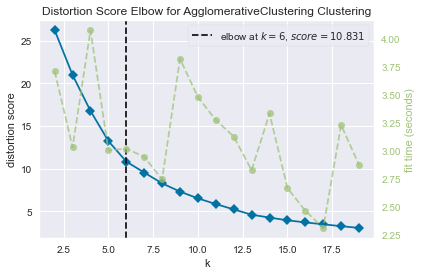

<AxesSubplot:title={'center':'Distortion Score Elbow for AgglomerativeClustering Clustering'}, xlabel='k', ylabel='distortion score'>

In [52]:
model = AgglomerativeClustering()
visualizer = KElbowVisualizer(estimator = model, k = (2,20))
visualizer.fit(x)
visualizer.poof()

In [91]:
cluster = AgglomerativeClustering(n_clusters=4, affinity='euclidean', linkage='ward')  
y_agg=cluster.fit_predict(x)

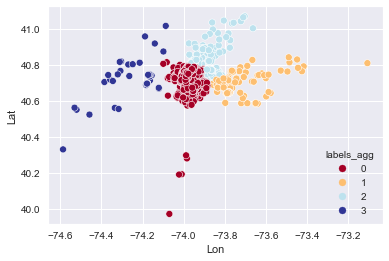

In [92]:
data_sample['labels_agg'] = cluster.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=data_sample, x='Lon', y='Lat', hue='labels_agg', palette='RdYlBu')
plt.show()

In [55]:
data_map_list_cluster1 = data_sample[['Lat','Lon']][data_sample['labels_agg']==0].values.tolist()
data_map_list_cluster2 = data_sample[['Lat','Lon']][data_sample['labels_agg']==1].values.tolist()
data_map_list_cluster3 = data_sample[['Lat','Lon']][data_sample['labels_agg']==2].values.tolist()
data_map_list_cluster4 = data_sample[['Lat','Lon']][data_sample['labels_agg']==3].values.tolist()
size_map_list_1 = len(data_map_list_cluster1)
size_map_list_2 = len(data_map_list_cluster2)
size_map_list_3 = len(data_map_list_cluster3)
size_map_list_4 = len(data_map_list_cluster4)

In [56]:
m_p= folium.Map(location=[40.7128, -74.0060], zoom_start=10,tiles = "openstreetmap")

for point in range(0,size_map_list_1):
    folium.CircleMarker(data_map_list_cluster1[point], radius=2,color='blue',fill_color='lightblue',).add_to(m_p)
for point in range(0,size_map_list_2):
    folium.CircleMarker(data_map_list_cluster2[point], radius=2,color='green',fill_color='lightgreen',).add_to(m_p)
for point in range(0,size_map_list_3):
    folium.CircleMarker(data_map_list_cluster3[point], radius=2,color='purple',fill_color='purple',).add_to(m_p)
for point in range(0,size_map_list_4):
    folium.CircleMarker(data_map_list_cluster4[point], radius=2,color='orange',fill_color='orange',).add_to(m_p)

m_p

# IV. DBSCAN

In [57]:
dbscan = DBSCAN(eps=0.009, min_samples=20,n_jobs=-1)
dbscan.fit(x)
y_dbscan = dbscan.fit_predict(x)
y_dbscan

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

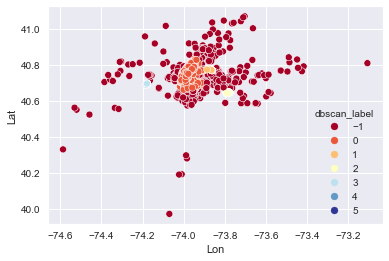

In [58]:
data_sample['dbscan_label'] =dbscan.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=data_sample, x='Lon', y='Lat', hue='dbscan_label', palette='RdYlBu')
plt.show()

In [64]:
data_map_list_cluster1 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==0].values.tolist()
data_map_list_cluster2 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==1].values.tolist()
data_map_list_cluster3 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==2].values.tolist()
data_map_list_cluster4 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==3].values.tolist()
data_map_list_cluster5 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==4].values.tolist()
data_map_list_cluster6 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==5].values.tolist()
data_map_list_cluster_1 = data_sample[['Lat','Lon']][data_sample['dbscan_label']==-1].values.tolist()
size_map_list_1 = len(data_map_list_cluster1)
size_map_list_2 = len(data_map_list_cluster2)
size_map_list_3 = len(data_map_list_cluster3)
size_map_list_4 = len(data_map_list_cluster4)
size_map_list_5 = len(data_map_list_cluster5)
size_map_list_6 = len(data_map_list_cluster6)
size_map_list__1 = len(data_map_list_cluster_1)

In [65]:
m_p= folium.Map(location=[40.7128, -74.0060], zoom_start=10,tiles = "openstreetmap")

for point in range(0,size_map_list_1):
    folium.CircleMarker(data_map_list_cluster1[point], radius=2,color='blue',fill_color='lightblue',).add_to(m_p)
for point in range(0,size_map_list_2):
    folium.CircleMarker(data_map_list_cluster2[point], radius=2,color='green',fill_color='lightgreen',).add_to(m_p)
for point in range(0,size_map_list_3):
    folium.CircleMarker(data_map_list_cluster3[point], radius=2,color='purple',fill_color='purple',).add_to(m_p)
for point in range(0,size_map_list_4):
    folium.CircleMarker(data_map_list_cluster4[point], radius=2,color='orange',fill_color='orange',).add_to(m_p)
for point in range(0,size_map_list_5):
    folium.CircleMarker(data_map_list_cluster5[point], radius=2,color='red',fill_color='red',).add_to(m_p)
for point in range(0,size_map_list_6):
    folium.CircleMarker(data_map_list_cluster6[point], radius=2,color='violet',fill_color='violet',).add_to(m_p)
for point in range(0,size_map_list__1):
    folium.CircleMarker(data_map_list_cluster_1[point], radius=2,color='brown',fill_color='brown',).add_to(m_p)

m_p

In [59]:
dbscan2 = DBSCAN(eps=0.015, min_samples=25,n_jobs=-1)
dbscan2.fit(x)
y_dbscan2 = dbscan.fit_predict(x)
y_dbscan2

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

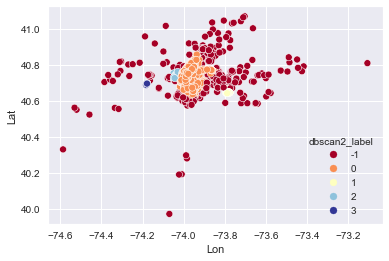

In [61]:
data_sample['dbscan2_label'] =dbscan2.labels_

sns.set_style('darkgrid')
sns.scatterplot(data=data_sample, x='Lon', y='Lat', hue='dbscan2_label', palette='RdYlBu')
plt.show()

In [ ]:
data_map_list_cluster1 = data_sample[['Lat','Lon']][data_sample['labels_agg']==0].values.tolist()
data_map_list_cluster2 = data_sample[['Lat','Lon']][data_sample['labels_agg']==1].values.tolist()
data_map_list_cluster3 = data_sample[['Lat','Lon']][data_sample['labels_agg']==2].values.tolist()
data_map_list_cluster4 = data_sample[['Lat','Lon']][data_sample['labels_agg']==3].values.tolist()
data_map_list_cluster_1 = data_sample[['Lat','Lon']][data_sample['labels_agg']==-1].values.tolist()
size_map_list_1 = len(data_map_list_cluster1)
size_map_list_2 = len(data_map_list_cluster2)
size_map_list_3 = len(data_map_list_cluster3)
size_map_list__1 = len(data_map_list_cluster_1)

In [66]:
m_p= folium.Map(location=[40.7128, -74.0060], zoom_start=10,tiles = "openstreetmap")

for point in range(0,size_map_list_1):
    folium.CircleMarker(data_map_list_cluster1[point], radius=2,color='blue',fill_color='lightblue',).add_to(m_p)
for point in range(0,size_map_list_2):
    folium.CircleMarker(data_map_list_cluster2[point], radius=2,color='green',fill_color='lightgreen',).add_to(m_p)
for point in range(0,size_map_list_3):
    folium.CircleMarker(data_map_list_cluster3[point], radius=2,color='purple',fill_color='purple',).add_to(m_p)
for point in range(0,size_map_list__1):
    folium.CircleMarker(data_map_list_cluster_1[point], radius=2,color='orange',fill_color='orange',).add_to(m_p)

m_p

# V. Models comparison

In [71]:
def unsupervised_metrics(X, y_pred):
    print("Silhouette Coefficient is equal to:")
    print(silhouette_score(X,y_pred))
    print("\nVariance Ratio Criterion is equal to:")
    print(calinski_harabasz_score(X, y_pred))
    print("\nDavides Bouldin score is equal to:")
    print(davies_bouldin_score(X, y_pred))

In [97]:
unsupervised_metrics(X=data_sample, y_pred=y_dbscan)
db1=silhouette_score(data_sample,y_dbscan)
db2=calinski_harabasz_score(data_sample, y_dbscan)
db3=davies_bouldin_score(data_sample, y_dbscan)

km1=silhouette_score(data_sample,y_kmeans)
km2=calinski_harabasz_score(data_sample, y_kmeans)
km3=davies_bouldin_score(data_sample, y_kmeans)

agg1=silhouette_score(data_sample,y_agg)
agg2=calinski_harabasz_score(data_sample, y_agg)
agg3=davies_bouldin_score(data_sample, y_agg)

Silhouette Coefficient is equal to:
0.3283543939746582

Variance Ratio Craterion is equal to:
396.52936825750743

Davides Bouldin score is equal to:
1.0011156131321075


In [96]:
results =pd.DataFrame({
    'k_means' : [km1, km2, km3],
    'Agglomerative_clustering' : [agg1, agg2, agg3],
    'DBSCAN' : [db1, db2, db3]
}, 
)
results

,k_means,Agglomerative_clustering,DBSCAN
0,0.829273,0.329660,0.328354
1,13275.859348,864.035439,396.529368
2,0.992447,1.815058,1.001116


In [100]:
results.set_axis(['Silhouette Coefficient', 'Variance Ratio Criterion', 'Davides Bouldin'], axis=0, inplace=True)
results

,k_means,Agglomerative_clustering,DBSCAN
Silhouette Coefficient,0.829273,0.329660,0.328354
Variance Ratio Criterion,13275.859348,864.035439,396.529368
Davides Bouldin,0.992447,1.815058,1.001116
